In [ ]:
# This is just to play the audio install these libraries and setup
!apt install musescore fluidsynth
!cp /usr/share/sounds/sf2/FluidR3_GM.sf2 ./font.sf2

Reading package lists... Done
Building dependency tree       
Reading state information... Done
Package musescore is not available, but is referred to by another package.
This may mean that the package is missing, has been obsoleted, or
is only available from another source

E: Package 'musescore' has no installation candidate
cp: cannot stat '/usr/share/sounds/sf2/FluidR3_GM.sf2': No such file or directory


In [ ]:
!pip install pebble fluidsynth midi2audio
!pip install pretty_midi

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for fluidsynth: filename=fluidsynth-0.2-py3-none-any.whl size=4513 sha256=a7cbc9e8b18401b1449ebf7665cd760ea5cf12333c138baaa90357574cdb1f71
  Stored in directory: /root/.cache/pip/wheels/26/65/f2/061218eaa5a047f720df1c6f863f9ef72364c88491a9623c23
Successfully built fluidsynth
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 43.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.1/51.1 kB 5.0 MB/s eta 0:00:00
  Created wheel for pretty_midi: filename=pretty_midi-0.2.10-py3-none-any.whl size=5592303 sha256=b521044419dc9f1ec5482edb83e8bacf496a2a3bdf3911aff4947e9451210b7f
  Stored in directory: /root/.cache/pip/wheels/75/ec/20/b8e937a5bcf1de547ea5ce465db7de7f6761e15e6f0a01e25f

In [ ]:
import numpy as np
import pretty_midi
from pretty_midi import Note
from midi2audio import FluidSynth
from IPython.display import Audio
from pathlib import Path


# Colab cannot play music directly from midi - so I have converted to .wav first

#This functions are just for playing and writing pretty midi to midi and wav format
def play_wav_pretty(pm, path_to_file, note_sequence=True):
    '''takes a pretty midi object or a pretty midi note sequence list if note_sequence=True'''
    #if a pretty midi note sequence is given then the following
    if note_sequence:
      midi = pretty_midi.PrettyMIDI()
      piano_track = pretty_midi.Instrument(program=0, is_drum=False, name='test')
      piano_track.notes = pm
      midi.instruments.append(piano_track)
      pm = midi
    pm.write(path_to_file)
    p = Path(path_to_file)
    out_wav = str(p.with_suffix('.wav'))
    FluidSynth("font.sf2").midi_to_audio(p, out_wav)
    return Audio(out_wav)


def write_midi(note_sequence, path_to_file):
    midi = pretty_midi.PrettyMIDI()
    piano_track = pretty_midi.Instrument(program=0, is_drum=False, name='test')
    piano_track.notes = note_sequence
    midi.instruments.append(piano_track)
    midi.write(path_to_file)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#This is the @title SequenceEncoder Class

#For Preprocessing I took help from the Code from Prayag Chatha pno-ai repository : https://github.com/chathasphere/pno-ai

import os, random, copy
import pretty_midi
from pretty_midi import ControlChange
import six
import numpy as np



def vectorize(sequence):
    """
    This function converts a list of pretty_midi Note objects into a numpy array of
    dimension (n_notes x 4)
    """
    array = [[note.start, note.end, note.pitch, note.velocity] for
            note in sequence]
    return np.asarray(array)

def devectorize(note_array):
    """
    This function converts a vectorized note sequence into a list of pretty_midi Note objects
    """
    return [Note(start = a[0], end = a[1], pitch=a[2],
        velocity=a[3]) for a in note_array.tolist()]


class PreprocessingPipeline():
    #set a random seed
    SEED = 1811
    """
    This class converts MIDI files to cleaned Piano Midi Note Sequences, split into
    a more manageable length.
    Applies any sustain pedal activity to extend note lengths.
    Optionally augments the data by transposing pitch and/or stretching sample speed. 
    Optionally quantizes timing and/or dynamics into smaller bins.

    Attributes:
        self.split_samples (a dict of lists): when the class is run, has two keys, "training" and "validation," each holding a list of split MIDI note sequences.
        self.encoded_sequences (a dict of lists): Keys are "training" and "validation." Each holds a list of encoded event sequences, a sparse numeric representation of a MIDI sample.
    """
    def __init__(self, input_dir, stretch_factors = [0.95, 0.975, 1, 1.025, 1.05],
            split_size = 30, sampling_rate = 125, n_velocity_bins = 32,
            transpositions = range(-3,4), training_val_split = 0.9,
            max_encoded_length = 512, min_encoded_length = 33):
        self.input_dir = input_dir
        self.split_samples = dict()
        self.stretch_factors = stretch_factors
        #size (in seconds) in which to split midi samples
        self.split_size = split_size
        #In hertz (beats per second), we will quantize sample timings to this discrete frequency
        #So a sampling rate of 125 hz means a smallest time steps of 8 ms
        self.sampling_rate = sampling_rate
        #Quantize sample dynamics (Velocity 1-127) to a smaller number of bins
        #this should be an *integer* dividing 128 : 2,4,8,16,32,64, or 128.
        self.n_velocity_bins = n_velocity_bins
        self.transpositions = transpositions

        #Fraction of raw MIDI data that goes to the training set
        #the remainder goes to validation
        self.training_val_split = training_val_split

        self.encoder = SequenceEncoder(n_time_shift_events = sampling_rate,
                n_velocity_events = n_velocity_bins,
                min_events = min_encoded_length,
                max_events = max_encoded_length)
        self.encoded_sequences = dict()

        random.seed(PreprocessingPipeline.SEED)

       


    def run(self):
        """
        This will parse midis, split into test and validation sets,
        augment, quantize, sample, and encode as event sequences.
        """
        midis = self.parse_files(chdir=True)
        total_time = sum([m.get_end_time() for m in midis])
        print("\n{} midis read, or {:.1f} minutes of music"\
                .format(len(midis), total_time/60))

        note_sequences = self.get_note_sequences(midis)

        del midis
        # note sequences are vectorized here
        note_sequences = [vectorize(ns) for ns in note_sequences]
        print("{} note sequences extracted\n".format(len(note_sequences)))
        self.note_sequences = self.partition(note_sequences)
        for mode, sequences in self.note_sequences.items():
            print(f"Processing {mode} data...")
            print(f"{len(sequences):,} note sequences")
            if mode == "training":
                sequences = self.stretch_note_sequences(sequences)
                print(f"{len(sequences):,} stretched note sequences")
            samples = self.split_sequences(sequences)
            self.quantize(samples)
            print(f"{len(samples):,} quantized, split samples")
            if mode == "training":
                samples = self.transpose_samples(samples)
                print(f"{len(samples):,} transposed samples")
            self.split_samples[mode] = samples
            self.encoded_sequences[mode] = self.encoder.encode_sequences(samples)

            print(f"Encoded {mode} sequences!\n")

    def parse_files(self, chdir=False):
        """
        Out here I will recursively parse all MIDI files in a given directory to PrettyMidi objects.
        """
        if chdir:
            home_dir = os.getcwd()
            os.chdir(self.input_dir)

        pretty_midis = []
        folders = [d for d in os.listdir(os.getcwd()) if os.path.isdir(d)]
        if len(folders) > 0:
            for d in folders:
                os.chdir(d)
                pretty_midis += self.parse_files()
                os.chdir("..")
        midis = [f for f in os.listdir(os.getcwd()) if \
                (f.endswith(".mid") or f.endswith("midi"))]

        print(f"Parsing {len(midis)} midi files in {os.getcwd()}...")
        for m in midis:
            with open(m, "rb") as f:
                try:
                    midi_str = six.BytesIO(f.read())
                    pretty_midis.append(pretty_midi.PrettyMIDI(midi_str))
                    #print("Successfully parsed {}".format(m))
                except:
                    print("Could not parse {}".format(m))
        if chdir:
            os.chdir(home_dir)

        return pretty_midis

    def get_note_sequences(self, midis):
        """
        Given a list of PrettyMidi objects, we will extract the Piano track as a list of
        Note objects and calls the "apply_sustain" method to extract the sustain pedal control changes.
        """

        note_sequences = []
        for m in midis:
            if m.instruments[0].program == 0:
                piano_data = m.instruments[0]
            else:
                
                raise PreprocessingError("Non-piano midi detected")
            note_sequence = self.apply_sustain(piano_data)
            note_sequence = sorted(note_sequence, key = lambda x: (x.start, x.pitch))
            note_sequences.append(note_sequence)

        return note_sequences



    def apply_sustain(self, piano_data):
        """
        While the sustain pedal is applied during a midi, 
        we will extend the length of all notes to the beginning of the next note of the same pitch or to
        the end of the sustain.
        This function returns a midi notes sequence.
        """
        _SUSTAIN_ON = 0
        _SUSTAIN_OFF = 1
        _NOTE_ON = 2
        _NOTE_OFF = 3

        notes = copy.deepcopy(piano_data.notes)
        control_changes = piano_data.control_changes
        #sequence of SUSTAIN_ON, SUSTAIN_OFF, NOTE_ON, and NOTE_OFF actions
        first_sustain_control = next((c for c in control_changes if c.number == 64),
                ControlChange(number=64, value=0, time=0))

        if first_sustain_control.value >= 64:
            sustain_position = _SUSTAIN_ON
        else:
            sustain_position = _SUSTAIN_OFF
        #if for some reason pedal was not touched...
        action_sequence = [(first_sustain_control.time, sustain_position, None)]
        #delete this please
        cleaned_controls = []
        for c in control_changes:
            #Ignoring the sostenuto and damper pedals due to complications
            if sustain_position == _SUSTAIN_ON:
                if c.value >= 64:
                    #another SUSTAIN_ON
                    continue
                else:
                    sustain_position = _SUSTAIN_OFF
            else:
                #look for the next on signal
                if c.value < 64:
                    #another SUSTAIN_OFF
                    continue
                else:
                    sustain_position = _SUSTAIN_ON
            action_sequence.append((c.time, sustain_position, None))
            cleaned_controls.append((c.time, sustain_position))

        action_sequence.extend([(note.start, _NOTE_ON, note) for note in notes])
        action_sequence.extend([(note.end, _NOTE_OFF, note) for note in notes])
        #sort actions by time and type

        action_sequence = sorted(action_sequence, key = lambda x: (x[0], x[1]))
        live_notes = []
        sustain = False
        for action in action_sequence:
            if action[1] == _SUSTAIN_ON:
                sustain = True
            elif action[1] == _SUSTAIN_OFF:
                #find when the sustain pedal is released
                off_time = action[0]
                for note in live_notes:
                    if note.end < off_time:
                        #shift the end of the note to when the pedal is released
                        note.end = off_time
                        live_notes.remove(note)
                sustain = False
            elif action[1] == _NOTE_ON:
                current_note = action[2]
                if sustain:
                    for note in live_notes:
                        # if there are live notes of the same pitch being held, we will kill them
                        if current_note.pitch == note.pitch:
                            note.end = current_note.start
                            live_notes.remove(note)
                live_notes.append(current_note)
            else:
                if sustain == True:
                    continue
                else:
                    note = action[2]
                    try:
                        live_notes.remove(note)
                    except ValueError:
                        print("***Unexpected note sequence...possible duplicate?")
                        pass
        return notes

    def partition(self, sequences):
       """
       This function partitions a list of Note sequences into a training set and validation set.
       It returns a dictionary {"training": training_data, "validation": validation_data}
       """
       partitioned_sequences = {}
       random.shuffle(sequences)

       n_training = int(len(sequences) * self.training_val_split)
       partitioned_sequences['training'] = sequences[:n_training]
       partitioned_sequences['validation'] = sequences[n_training:]

       return partitioned_sequences

    def stretch_note_sequences(self, note_sequences):
        """
        This function stretches tempo (note start and end time) for each sequence in a given list
        by each of the pipeline's stretch factors. Returns a list of Note sequences.
        """
        stretched_note_sequences = []
        for note_sequence in note_sequences:
            for factor in self.stretch_factors:
                if factor == 1:
                    stretched_note_sequences.append(note_sequence)
                    continue
                stretched_sequence = np.copy(note_sequence)
                #stretch note start time
                stretched_sequence[:,0] *= factor
                #stretch note end time
                stretched_sequence[:,1] *= factor
                stretched_note_sequences.append(stretched_sequence)

        return stretched_note_sequences


    def split_sequences(self, sequences):
        """
        Given a list of Note sequences, we split them into samples no longer than
        a given length. Returns a list of split samples.
        """

        samples = []
        if len(sequences) == 0:
            raise PreprocessingError("No note sequences available to split")

        for note_sequence in sequences:
            sample_length = 0
            sample = []
            i = 0
            while i < len(note_sequence):
                note = np.copy(note_sequence[i])
                if sample_length == 0:
                    sample_start = note[0]
                    if note[1] > self.split_size + sample_start:
                       
                        note[1] = sample_start + self.split_size
                    sample.append(note)
                    sample_length = self.split_size
                else:
                    if note[1] <= sample_start + self.split_size:
                        sample.append(note)
                        if note[1] > sample_start + sample_length:
                            sample_length = note[1] - sample_start
                    else:
                        samples.append(np.asarray(sample))
                       
                        sample_length = 0
                        sample = []
                i += 1
        return samples

    def quantize(self, samples):
        """
        Quantize timing and dynamics in a Note sample in place. This converts continuous
        time to a discrete, encodable quantity and simplifies input for the model.
        Quantizes note start/ends to a smallest perceptible timestep (~8ms) and note
        velocities into a few audibly distinct bins (around 32).
        """
        #define smallest timestep (in seconds)
        try:
            timestep = 1 / self.sampling_rate
        except ZeroDivisionError:
            timestep = 0
        #define smallest dynamics increment
        try:
            velocity_step = 128 // self.n_velocity_bins
        except ZeroDivisionError:
            velocity_step = 0
        for sample in samples:
            sample_start_time = next((note[0] for note in sample), 0)
            for note in sample:
                #reshift note start and end times to begin at zero
                note[0] -= sample_start_time
                note[1] -= sample_start_time
               
                if note[0] < 0 or note[1] < 0:
                    raise PreprocessingError
                if timestep:
                   
                    note[0] = (note[0] * self.sampling_rate) // 1 * timestep
                    note[1] = (note[1] * self.sampling_rate) // 1 * timestep
                if velocity_step:
                    #quantize dynamics
                    #smallest velocity is 1 (otherwise we can't hear it!)
                    note[3] = (note[3] // velocity_step *\
                            velocity_step) + 1

    def transpose_samples(self, samples):
        """
        Transposes the pitch of a sample note by note according to a list of intervals.
        """
        transposed_samples = []
        for sample in samples:
            for transposition in self.transpositions:
                if transposition == 0:
                    transposed_samples.append(sample)
                    continue
                transposed_sample = np.copy(sample)
              
                transposed_sample[:,2] += transposition
               
                transposed_samples.append(transposed_sample)

        return transposed_samples




class SequenceEncoder():
    """
    This function converts Midi note sequences to event sequences using the following representation:
    - 128 NOTE-ON events (each of the 128 MIDI pitches initiates a new note).
    - 128 NOTE-OFF events (similarly. Ends: - (1000/t) TIME-SHIFT events advance the time step by increments of t ms to 1 second.
    - Velocity events affect the velocity of succeeding notes until another event occurs.
    It also includes routines for converting Midi Notes to a list of probable events and encoding a numeric sequence as a Pytorch tensor.
    """

    def __init__(self, n_time_shift_events, n_velocity_events,
             min_events=33, max_events=512):
        self.n_time_shift_events = n_time_shift_events
        self.n_events = 128 + n_time_shift_events + n_velocity_events
        self.timestep = 1 / n_time_shift_events
        self.velocity_bin_size = 128 // n_velocity_events

        self.min_events = min_events
        self.max_events = max_events

    def encode_sequences(self, sample_sequences):
        """
        Converts each sample note sequence into an "event" sequence, a list of integers
        0 through N-1 where N is the total number of events in the encoder's
        representation.
        """
        event_sequences = []
        #count how many sequences are discarded/truncated due to length
        short_count, long_count = 0,0

        for i in range(len(sample_sequences)):
            if (i % 50000 == 0): print(f"{i} / {len(sample_sequences)} sequences encoded")
            event_sequence = []
            event_timestamps = []
           
            for note in sample_sequences[i]:
                #extract start/end time, pitch and velocity
                t0, t1, p, v = note
                event_timestamps.append((t0, "VELOCITY", v))

                event_timestamps.append((t0, "NOTE_ON", p))
                event_timestamps.append((t1, "NOTE_OFF", p))

            # sort events by timestamp
            event_timestamps = sorted(event_timestamps, key = lambda x: x[0])
            current_time = 0
            max_timeshift = self.n_time_shift_events
           
            for timestamp in event_timestamps:
                #capture a shift in absolute time
                if timestamp[0] != current_time:
                    #convert to relative time and convert to number of quantized timesteps
                    timeshift = (timestamp[0] *  self.n_time_shift_events) - \
                            (current_time * self.n_time_shift_events)
                 
                    timeshift = int(timeshift + .1)
                    timeshift_events = []
                   
                    while timeshift > max_timeshift:
                        timeshift_events.append(
                                self.event_to_number("TIME_SHIFT", max_timeshift))
                        timeshift -= max_timeshift
                    #add timeshift (mod 1 second) as an event
                    timeshift_events.append(
                            self.event_to_number("TIME_SHIFT", timeshift))
                    event_sequence.extend(timeshift_events)

                    #add the other events: NOTE_ON, NOTE_OFF, VELOCITY
                    current_time = timestamp[0]
                event_sequence.append(
                        self.event_to_number(timestamp[1], timestamp[2]))

            #check if sequence is too short to keep
            if self.min_events is not None:
                if len(event_sequence) < self.min_events:
                    short_count += 1
                    continue
            #truncate sequence if necessary
            if self.max_events is not None:
                if len(event_sequence) > self.max_events:
                    event_sequence = event_sequence[:self.max_events]
                    long_count += 1

            event_sequences.append(event_sequence)

        if short_count > 0:
            print(f"{short_count} sequences discarded due to brevity")
        if long_count > 0:
            print(f"{long_count} sequences truncated due to excessive length.")

        return event_sequences


    def event_to_number(self, event, value):
        """
        Encode an event/value pair as a number 0-N-1
        where N is the number of unique events in the Encoder's representation.
        """
        if event == "NOTE_ON":
            return value
        elif event == "NOTE_OFF":
            return value + 128
        elif event == "TIME_SHIFT":
            #subtract one to fit to zero-index convention
            #i.e. the number 256 corresponds to the smallest possible timestep
            #which is non-zero...!
            return value + 256 - 1
        elif event == "VELOCITY":
            #convert to bins
            v_bin = (value - 1) // self.velocity_bin_size
            return v_bin + 256 + self.n_time_shift_events
        else:
            raise SequenceEncoderError("Event type {} not recognized".format(event))

    def number_to_event(self, number):
        number = int(number)
        if number < 0 or number >= self.n_events:
            raise SequenceEncoderError("Number {} out of range")

        #changed for limited range
        if number < 64:   #128:
            event = "NOTE_ON", number + 33
        elif 64 <= number < 128:
            event = "NOTE_OFF", number - 31
        elif 128 <= number < 128 + self.n_time_shift_events:
            event = "TIME_SHIFT", number + 1 - 128
        else:
            bin_number = number - 128 - self.n_time_shift_events
            event = "VELOCITY", (bin_number * self.velocity_bin_size) + 1
        return event

    def decode_sequences(self, encoded_sequences):
        """
        Given a list of encoded sequences, decode each of them and return a list of pretty_midi Note sequences.
        """
        note_sequences = []
        for encoded_sequence in encoded_sequences:
            print(encoded_sequence)
            note_sequences.append(self.decode_sequence(encoded_sequence))

        return note_sequences

    def decode_sequence(self, encoded_sequence, stuck_note_duration=None, keep_ghosts=False, verbose=True):
       
        events = []
        for num in encoded_sequence:
            events.append(self.number_to_event(num))
        print(events)

        #list of pseudonotes = {'start':x, 'pitch':something, 'velocity':something}
        notes = []
        #on the second pass, add in end time
        note_ons = []
        note_offs = []
        global_time = 0
        current_velocity = 0
        for event, value in events:
            #check event type
            if event == "TIME_SHIFT":
                global_time += 0.008 * value
                global_time = round(global_time, 5)

            elif event == "VELOCITY":
                current_velocity = value

            elif event == "NOTE_OFF":
                #eventually we'll sort this by timestamp and work thru
                note_offs.append({"pitch": value, "end": global_time})

            elif event == "NOTE_ON":
                #it's a NOTE_ON!
                #value is pitch
                note_ons.append({"start": global_time,
                    "pitch": value, "velocity": current_velocity})
            else:
                raise SequenceEncoderError("you fool!")

        print(note_ons)
        print(note_offs)
        
        stuck_notes = 0

        ghost_notes = 0


        while len(note_ons) > 0:
            note_on = note_ons[0]
            pitch = note_on['pitch']
            #this assumes everything is sorted nicely!
            note_off = next((n for n in note_offs if n['pitch'] == pitch), None)
            if note_off == None:
                stuck_notes += 1
                if stuck_note_duration is None:
                    note_ons.remove(note_on)
                    continue
                else:
                    note_off = {"pitch": pitch, "end": note_on['start'] + stuck_note_duration}
            else:
                note_offs.remove(note_off)

            if note_off['end'] < note_on['start']:
                ghost_notes += 1
                if keep_ghosts:
                    
                    new_end = note_on['start']
                    new_start = note_off['end']
                    note_on['start'] = new_start
                    note_off['end'] = new_end
                else:
                    note_ons.remove(note_on)
                    continue

            note = Note(start = note_on['start'], end = note_off['end'],
                    pitch = pitch, velocity = note_on['velocity'])
            notes.append(note)
            note_ons.remove(note_on)

        if verbose:
            print(f"{stuck_notes} notes missing an end-time...")
            print(f"{ghost_notes} had an end-time precede their start-time")

        return notes

IndentationError: ignored

In [ ]:
import json

preprocess = PreprocessingPipeline('/content/drive/MyDrive/Music_Maker/maestro/maestro-v3.0.0')
#preprocess.run()

#with open('/content/drive/MyDrive/Music_Maker/maestro/encoded_data.json', 'w') as f:
#  json.dump(preprocess.encoded_sequences, f)

In [ ]:
encoded_sequences = preprocess.encoded_sequences

In [ ]:
import json
with open('/content/drive/MyDrive/Music_Maker/maestro/encoded_data.json', 'r') as f:
 
  encoded_sequences = json.load(f)

In [ ]:
print(encoded_sequences.keys())

dict_keys([])


In [ ]:
#Load Encoded Sequences

train_seq =  encoded_sequences['training']
val_seq =  encoded_sequences['validation']

print(f'{len(train_seq)} training sequences, {len(val_seq)} validation sequences')


231 training sequences, 24 validation sequences


In [ ]:
#function to convert to new reduced vocab indices

def get_new_encoding(num):
  #NOTE ON -> 0-63
  if num< 128:
    while num > 96: #high C
      num -= 12
    while num < 33: #low A
      num += 12
    num -= 33

 
  elif 128 <= num < 256:
    num -= 128
    while num > 96:
      num -= 12
    while num < 33:
      num += 12
    num += 31  #-33+64

  elif num >= 256:
    num -= 128

  return num

#create dicitonary to map from old encoding to new encoding
keys = list(range(413)) #413 is original vocabulary size
vals = [get_new_encoding(k) for k in keys]
new_enc_dict = dict(zip(keys, vals))
#print(new_enc_dict)


def get_new_encode_seq(sequence):
  #map sequence to new encoding
  return list(map(new_enc_dict.get, sequence))


def shorten_sequences(sequence):
  n = len(sequence)
  return [sequence[i:i+100] for i in range(n-100+1)]

In [ ]:
#NEW VOCAB SIZE

set_vals = set(vals)
len(list(set_vals))

285

In [ ]:
import numpy as np

train_seq = list(map(get_new_encode_seq, train_seq))
val_seq = list(map(get_new_encode_seq, val_seq))

#save to prevent crash
np.save('/content/drive/MyDrive/Music_Maker/ENCODINGS/maestro_new_enc_train.npy', np.array(train_seq))
np.save('/content/drive/MyDrive/Music_Maker/ENCODINGS/maestro_new_enc_val.npy', np.array(val_seq))


<ipython-input-28-2338b9557a4c>:8: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.save('/content/drive/MyDrive/Music_Maker/ENCODINGS/maestro_new_enc_val.npy', np.array(val_seq))


In [ ]:
#unique_vals = set()
for seq in val_seq:
  unique_vals |= set(seq)

print(len(unique_vals))

254


In [ ]:
import numpy as np

In [ ]:
#load sequence datasets
train_seq =  np.load('/content/drive/MyDrive/Music_Maker/ENCODINGS/maestro_new_enc_train.npy', allow_pickle=True)
val_seq =  np.load('/content/drive/MyDrive/Music_Maker/ENCODINGS/maestro_new_enc_val.npy', allow_pickle=True)

print(f'{len(train_seq)} training sequences, {len(val_seq)} validation sequences')


231 training sequences, 24 validation sequences


In [ ]:
#train_seq = list(map(shorten_sequences, train_seq))
#val_seq = list(map(shorten_sequences, val_seq))
import itertools

train_seqn =  list(itertools.chain.from_iterable(list(map(shorten_sequences, train_seq))))
val_seqn = list(itertools.chain.from_iterable(list(map(shorten_sequences, val_seq))))

print(f'{len(train_seqn)} training sequences, {len(val_seqn)} validation sequences')

95403 training sequences, 9317 validation sequences


In [ ]:
print(train_seqn[0])

train_seq = train_seqn
val_seq = val_seqn

[262   2 156 263   9 154 266  17 169 267  26 158 264  38 264  31 132  81
 262  17 145 267  40 129 263  33 128 265  14 144 102 270  38 129 268  24
 129 265  29 144 104 270  40 131  81 267  17 128  97 266  33 144  73 268
   9 128 270  36 133 260  28 152  66 104 266   2 268  40 130  97 265  33
 130  90  78  88  81 100 144  73 265   9 150 265  17 157 270  26 148  81
 266  17 131 102 267  38 130  95 261  31]


In [ ]:
print(len(train_seqn[0]))

100


**Transformer Model**

In [ ]:
import math
import torch
import torch.nn as nn
import torch.nn.functional as F

class TransformerModel(nn.Module):

    def __init__(self, ntoken, d_model,  nhead, dim_feedforward, nlayers, dropout=0.5):
        super(TransformerModel, self).__init__()
        self.ntoken = ntoken
        from torch.nn import TransformerEncoder, TransformerEncoderLayer
        self.model_type = 'Transformer'
        self.pos_encoder = PositionalEncoding(d_model, dropout)
        encoder_layers = TransformerEncoderLayer(d_model, nhead, dim_feedforward, dropout, activation='relu')   #applies self attention and feed forward network       self.transformer_encoder = TransformerEncoder(encoder_layers, nlayers)
        self.transformer_encoder = TransformerEncoder(encoder_layers, nlayers)  #stacks number of encoder layers
        self.embedding = nn.Embedding(ntoken, d_model)
        self.d_model = d_model
        self.decoder = nn.Linear(d_model, ntoken) #outputs logits of next token in sequence

        self.init_weights()

    def generate_square_subsequent_mask(self, sz):
        mask = (torch.triu(torch.ones(sz, sz)) == 1).transpose(0, 1)
        mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
        return mask

    def init_weights(self):
        initrange = 0.1
        self.embedding.weight.data.uniform_(-initrange, initrange)
        self.decoder.bias.data.zero_()
        self.decoder.weight.data.uniform_(-initrange, initrange)

    def forward(self, src, src_mask):
        src = self.embedding(src) * math.sqrt(self.d_model) #scale by sqrt of d_model
        src = self.pos_encoder(src)
        output = self.transformer_encoder(src, src_mask)
        output = self.decoder(output)
        return output

class PositionalEncoding(nn.Module):

    def __init__(self, d_model, dropout=0.1, max_len=5000):
        super(PositionalEncoding, self).__init__()
        self.dropout = nn.Dropout(p=dropout)

        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len, dtype=torch.float).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2).float() * (-math.log(10000.0) / d_model))
        #even positions
        pe[:, 0::2] = torch.sin(position * div_term)
        #odd positions
        pe[:, 1::2] = torch.cos(position * div_term) #[:, :-1] #odd number of tensor
        #include batch dimension
        pe = pe.unsqueeze(0).transpose(0, 1)
        self.register_buffer('pe', pe)

    def forward(self, x):
        x = x + self.pe[:x.size(0), :]
        return self.dropout(x)

In [ ]:
#Functions to batch data and get input and output tensors adapted from pno-ai https://github.com/chathasphere/pno-ai

def batchify(sequences, batch_size):
  '''list of sequences -> batches of inputs and targets of batch_size
  '''
  for i in range(0, len(sequences), batch_size):
    batch = sequences[i:i+batch_size]
	  #needs to be in sorted order for packing batches to work
    batch = sorted(batch, key = len, reverse=True)
    inputs, targets = [], []

    for sequence in batch:
      inputs.append(sequence[:-1])
      targets.append(sequence[1:]) #shift one forward

    yield inputs, targets

def batch_to_tensors(batch, n_tokens, max_length):
    """
    Make input, input mask, and target tensors for a batch of seqa batch of sequences.
    """
    input_sequences, target_sequences = batch

    #print("batch_to_tensors")
    #print(input_sequences[0][:10], target_sequences[0][:10])

    sequence_lengths = [len(s) for s in input_sequences]
    batch_size = len(input_sequences)

    #print("sequence_lengths", sequence_lengths)
    #print("batch_size", batch_size)

    x = torch.zeros(max_length, batch_size, dtype=torch.long)
    y = torch.zeros(max_length, batch_size, dtype=torch.long)


    for i, sequence in enumerate(input_sequences):
        seq_length = sequence_lengths[i]
        x[:seq_length, i] = torch.Tensor(sequence)

    for i, sequence in enumerate(target_sequences):
        seq_length = sequence_lengths[i]
        y[:seq_length, i] = torch.Tensor(sequence)

    return x, y


In [ ]:
sampling_rate = 125
n_velocity_bins = 32
seq_length = 1024
n_tokens = 285

In [ ]:
ntokens = 285   # the size of vocabulary
emsize = 32   # embedding dimension
dim_feedforward = 512 # the dimension of the feedforward network model in nn.TransformerEncoder
nlayers = 4   # the number of nn.TransformerEncoderLayer in nn.TransformerEncoder
nhead = 4   # the number of heads in the multiheadattention models
dropout = 0.1   # the dropout value
model = TransformerModel(ntokens, emsize, nhead, dim_feedforward, nlayers, dropout)  #.to(device)


#S is the source sequence length,
#T is the target sequence length,
#N is the batch size,
#E is the feature number

In [ ]:
len(train_seq), len(val_seq)

(95403, 9317)

**Model Training**


In [ ]:


criterion = nn.CrossEntropyLoss()
lr = 0.5 # learning rate
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, 1.0, gamma=0.96)

import time
def train():
    model.train() # Turn on the train mode
    total_loss = 0.
    n_batches = 0

    start_time = time.time()
    for i, batch in enumerate(training_batches):
      #skip batches that are undersized
      #if len(batch[0][0]) != batch_size:
      #  continue

      #print(len(batch))
      #print(len(batch[0]))
      #print(len(batch[0][0]))


      inp, trg = batch_to_tensors(batch, ntokens, max_length) #(S,N,E)

      #print(inp[0], trg[0])
      optimizer.zero_grad()
      src_mask = model.generate_square_subsequent_mask(inp.size(0)) #(S,S)
      output = model(inp, src_mask) #(S, N, E)
      loss = criterion(output.view(-1, ntokens), trg.view(-1))
      loss.backward()
      torch.nn.utils.clip_grad_norm_(model.parameters(), 0.5)
      optimizer.step()
      n_batches += 1
      total_loss += loss.item()

    if (epoch % eval_per == 0):
      elapsed = time.time() - start_time
      print(f'| epoch {epoch} | {n_batches} batches | lr: {scheduler.get_last_lr()[0]} | {elapsed} ms ')
    try:
      loss_avg = total_loss / (n_batches*batch_size)
      print(f'\n Training Loss: {loss_avg}')
      training_losses.append(loss_avg)
    except:
      print('Error: 0 batches processed in loop')

def evaluate(eval_model, val_batches):
    eval_model.eval() # Turn on the evaluation mode
    total_loss = 0.
    n_batches = 0
    with torch.no_grad():
        for i, batch in enumerate(validation_batches):
            if len(batch[0]) != batch_size:
              continue
            inputs, targets = batch_to_tensors(batch, ntokens, max_length) #(S, N, E)
            src_mask = model.generate_square_subsequent_mask(inputs.size(0))  #.to(device) #(S, S)
            output = eval_model(inputs, src_mask) #(S, N, E)
            output_flat = output.view(-1, ntokens) #(S*N, E)
            total_loss +=  criterion(output_flat, targets.view(-1)).item()
            n_batches += 1
    return total_loss / (n_batches*batch_size)


In [ ]:
best_val_loss = float("inf")
epochs = 50 # The number of epochs
best_model = None
max_length = max((len(L) for L in train_seq)) - 1

path = "/content/drive/MyDrive/Music_Maker/MODELS/transformer_b.pt"

training_losses = []
validation_losses = []
eval_per = 10

for epoch in range(epochs):
    batch_size = 16
    training_batches = batchify(train_seq, batch_size)
    validation_batches = batchify(val_seq, batch_size)


    epoch_start_time = time.time()
    train()
    if (epoch % eval_per == 0):
      #print(f'epoch: {epoch+1}')
      val_loss = evaluate(model, validation_batches)
      if val_loss < best_val_loss:
        torch.save(model.state_dict(), f'/content/drive/MyDrive/Music_Maker/MODELS/transformer_b_e{epoch}.pt')
        best_val_loss = val_loss
        best_model = model

      validation_losses.append(val_loss)
      print(f'Validation Loss: {val_loss}')

    scheduler.step()

np.save('/content/drive/MyDrive/Music_Maker/MODELS/trainlosses_1', np.array(training_losses))
np.save('/content/drive/MyDrive/Music_Maker/MODELS/vallosses_1', np.array(validation_losses))

| epoch 0 | 5963 batches | lr: 0.5 | 454.1605911254883 ms 

 Training Loss: 0.8527644309155117
Validation Loss: 1.5378765816131408

 Training Loss: 0.8037226056714756

 Training Loss: 0.6852724414563071

 Training Loss: 0.5700207737924348

 Training Loss: 0.505178820411171

 Training Loss: 0.4624262873746196

 Training Loss: 0.4211361915717764

 Training Loss: 0.397918253192441

 Training Loss: 0.3783825615493719

 Training Loss: 0.36079405780438706
| epoch 10 | 5963 batches | lr: 0.33241631799575044 | 465.78161120414734 ms 

 Training Loss: 0.34897985431685374
Validation Loss: 0.5095471487319756

 Training Loss: 0.3407465463219004

 Training Loss: 0.33344269163173135

 Training Loss: 0.3266559730919739


In [ ]:
#torch.save(model.state_dict(), f'/content/drive/MyDrive/Music Maker/MODELS/transformer2_ma_e0.pt')


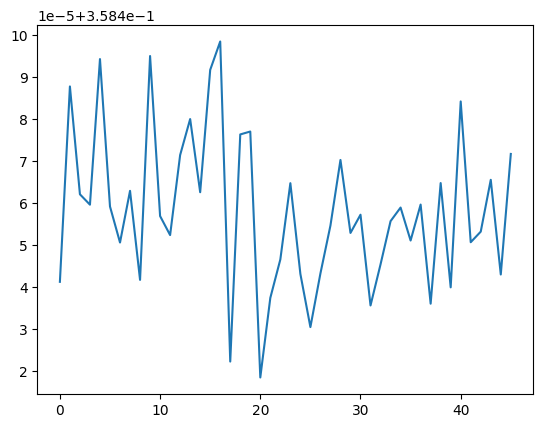

In [ ]:
#Plot Training and Validation Losses
import matplotlib.pyplot as plt

#training_losses = np.load('/content/drive/MyDrive/Music Maker/MODELS/trainlosses_1.npy')
#validation_losses = np.load('/content/drive/MyDrive/Music Maker/MODELS/vallosses_1.npy')

plt.plot(training_losses)

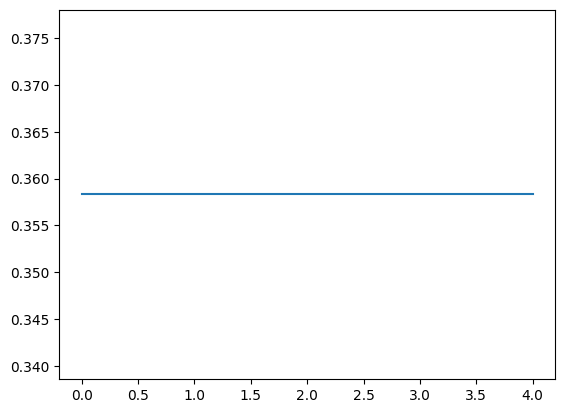

In [ ]:
plt.plot(validation_losses)

**Generation!**


In [ ]:
#After initiating model load state dictionary

model.load_state_dict(torch.load('/content/drive/MyDrive/Music_Maker/MODELS/transformer_a_e20.pt'))

FileNotFoundError: ignored

In [ ]:
!apt-get update -qq && apt-get install -qq libfluidsynth1 fluid-soundfont-gm


E: Package 'libfluidsynth1' has no installation candidate


In [ ]:
!pip install fluidsynth

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!sudo apt install -y fluidsynth

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  fluid-soundfont-gm libfluidsynth2 libinstpatch-1.0-2 qsynth
  timgm6mb-soundfont
Suggested packages:
  fluid-soundfont-gs timidity jackd musescore
The following NEW packages will be installed:
  fluid-soundfont-gm fluidsynth libfluidsynth2 libinstpatch-1.0-2 qsynth
  timgm6mb-soundfont
0 upgraded, 6 newly installed, 0 to remove and 24 not upgraded.
Need to get 126 MB of archives.
After this operation, 157 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal/universe amd64 fluid-soundfont-gm all 3.1-5.1 [119 MB]
Get:2 http://archive.ubuntu.com/ubuntu focal/universe amd64 libinstpatch-1.0-2 amd64 1.1.2-2build1 [238 kB]
Get:3 http://archive.ubuntu.com/ubuntu focal/universe amd64 timgm6mb-soundfont all 1.3-3 [5,420 kB]
Get:4 http://archive.ubuntu.com/ubuntu focal/universe amd64 libfluidsynth2 amd64 2.1.1-2 [

In [ ]:
!pip install --upgrade pyfluidsynth


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import fluidsynth

In [ ]:
#GENERATE

def generate_song(input_sequence, length):
  if len(input_sequence) == 0:
        s = [np.random.randint(ntokens)] #random starting event
  else:
        s = input_sequence.copy()
  result = torch.empty((length, 1), dtype = torch.long)
  result[0:len(s), :] = torch.tensor(s).unsqueeze(-1)

  model.eval()
  with torch.no_grad():
    for i in range(len(s), length):
      src_mask = model.generate_square_subsequent_mask(i)
      out = model(result[0:i], src_mask)
      probs = F.softmax(out[-1], dim=0)
      c = torch.multinomial(probs, 1) #sample prob distribution
      result[i, :] = c
  return result.squeeze().tolist() #convert tensor to note token list


#functions to play pretty midi outputs

from midi2audio import FluidSynth

def play_wav_pretty(pm, path_to_file, note_sequence=True):
    '''takes a pretty midi object or a pretty midi note sequence list if note_sequence=True'''
    print("play_wav_pretty")
    if note_sequence:
      midi = pretty_midi.PrettyMIDI()
      piano_track = pretty_midi.Instrument(program=0, is_drum=False, name='test')
      piano_track.notes = pm
      midi.instruments.append(piano_track)
      pm = midi
    pm.write(path_to_file)
    p = Path(path_to_file)
    out_wav = str(p.with_suffix('.wav'))
    print("FluidSynth")
    FluidSynth("font.sf2").midi_to_audio(p, out_wav)
    return Audio(out_wav)


def write_midi(note_sequence, path_to_file):
    midi = pretty_midi.PrettyMIDI()
    piano_track = pretty_midi.Instrument(program=0, is_drum=False, name='test')
    piano_track.notes = note_sequence
    midi.instruments.append(piano_track)
    midi.write(path_to_file)


In [ ]:
#GET SEED
input_seed = val_seq[19][:100] #input seed of music event tokens

print(input_seed)

ns = preprocess.encoder.decode_sequences([input_seed])
#ns = sequence_encoder.decode_sequences([input_seed])

print(ns[0])
play_wav_pretty(ns[0], 'seed.midi')

[274, 28, 131, 274, 25, 158, 278, 15, 129, 275, 3, 130, 268, 6, 145, 279, 14, 129, 275, 2, 131, 269, 4, 128, 92, 79, 70, 273, 24, 130, 68, 129, 66, 131, 268, 27, 131, 272, 30, 133, 272, 35, 141, 274, 36, 136, 273, 39, 132, 273, 42, 135, 273, 47, 136, 99, 279, 35, 128, 91, 94, 275, 30, 274, 27, 128, 88, 273, 24, 130, 276, 48, 138, 275, 51, 132, 274, 54, 137, 274, 59, 129, 99, 279, 35, 128, 94, 274, 30, 128, 91, 88, 273, 24, 273, 27, 138, 274, 60, 137]
[274, 28, 131, 274, 25, 158, 278, 15, 129, 275, 3, 130, 268, 6, 145, 279, 14, 129, 275, 2, 131, 269, 4, 128, 92, 79, 70, 273, 24, 130, 68, 129, 66, 131, 268, 27, 131, 272, 30, 133, 272, 35, 141, 274, 36, 136, 273, 39, 132, 273, 42, 135, 273, 47, 136, 99, 279, 35, 128, 91, 94, 275, 30, 274, 27, 128, 88, 273, 24, 130, 276, 48, 138, 275, 51, 132, 274, 54, 137, 274, 59, 129, 99, 279, 35, 128, 94, 274, 30, 128, 91, 88, 273, 24, 273, 27, 138, 274, 60, 137]
[('VELOCITY', 85), ('NOTE_ON', 61), ('TIME_SHIFT', 4), ('VELOCITY', 85), ('NOTE_ON', 58), 

In [ ]:
#generate song of desired length of tokens
pred_song = generate_song(input_seed, 300)


In [ ]:
#decode tokens to pretty midi note sequence
pm_note_sequence = preprocess.encoder.decode_sequence(pred_song)


#save and play midi/wav
play_wav_pretty(pm_note_sequence, 'output3.midi')  #the Audio play function seems to only work for shorter sequences

[('VELOCITY', 85), ('NOTE_ON', 61), ('TIME_SHIFT', 4), ('VELOCITY', 85), ('NOTE_ON', 58), ('TIME_SHIFT', 31), ('VELOCITY', 101), ('NOTE_ON', 48), ('TIME_SHIFT', 2), ('VELOCITY', 89), ('NOTE_ON', 36), ('TIME_SHIFT', 3), ('VELOCITY', 61), ('NOTE_ON', 39), ('TIME_SHIFT', 18), ('VELOCITY', 105), ('NOTE_ON', 47), ('TIME_SHIFT', 2), ('VELOCITY', 89), ('NOTE_ON', 35), ('TIME_SHIFT', 4), ('VELOCITY', 65), ('NOTE_ON', 37), ('TIME_SHIFT', 1), ('NOTE_OFF', 61), ('NOTE_OFF', 48), ('NOTE_OFF', 39), ('VELOCITY', 81), ('NOTE_ON', 57), ('TIME_SHIFT', 3), ('NOTE_OFF', 37), ('TIME_SHIFT', 2), ('NOTE_OFF', 35), ('TIME_SHIFT', 4), ('VELOCITY', 61), ('NOTE_ON', 60), ('TIME_SHIFT', 4), ('VELOCITY', 77), ('NOTE_ON', 63), ('TIME_SHIFT', 6), ('VELOCITY', 77), ('NOTE_ON', 68), ('TIME_SHIFT', 14), ('VELOCITY', 85), ('NOTE_ON', 69), ('TIME_SHIFT', 9), ('VELOCITY', 81), ('NOTE_ON', 72), ('TIME_SHIFT', 5), ('VELOCITY', 81), ('NOTE_ON', 75), ('TIME_SHIFT', 8), ('VELOCITY', 81), ('NOTE_ON', 80), ('TIME_SHIFT', 9), ('

In [ ]:
#generate song with random token input seed

pred_song2 = generate_song([], 300)

In [ ]:
#decode tokens to pretty midi note sequence
pm_note_sequence2 = sequence_encoder.decode_sequence(pred_song2)
#save and play midi/wav
play_wav_pretty(pm_note_sequence2[:20], 'test_output2.midi')